In [1]:
%pip install decorator==5.0.9

import imp
import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt
import networkx as nx

Note: you may need to restart the kernel to use updated packages.


In [2]:
# importing local modules

import sys
sys.path.append('../src/')

import text_cleanup.text_cleanup as thesisCleanUp
import preprocessing.text_preprocessing as thesisTextPreprocessing
import data.reader as thesisDataReader
import utils.utils as thesisUtils

imp.reload(thesisCleanUp)
imp.reload(thesisTextPreprocessing)
imp.reload(thesisDataReader)
imp.reload(thesisUtils)

<module 'utils.utils' from '../src/utils/utils.py'>

In [3]:
a_zwickau_text = thesisDataReader.read_a_zwickau()
b_london_text = thesisDataReader.read_b_london()

In [4]:
a_zwickau_corpus = thesisCleanUp.create_corpus_by_line(thesisCleanUp.jvtext(a_zwickau_text))
b_london_corpus = thesisCleanUp.create_corpus_by_line(thesisCleanUp.jvtext(b_london_text))

In [5]:
a_zwickau_corpus = list(map(lambda x: x.replace(' ', ''), a_zwickau_corpus))
b_london_corpus = list(map(lambda x: x.replace(' ', ''), b_london_corpus))

In [6]:
def get_features(corpus):
    vectorizer = TfidfVectorizer(ngram_range=(4,4), analyzer='char')
    sparse_matrix = vectorizer.fit_transform(corpus)
    doc_term_matrix = sparse_matrix.todense()
    df = pd.DataFrame(doc_term_matrix, columns=vectorizer.get_feature_names())
    return df

In [7]:
a_zwickau_df = get_features(a_zwickau_corpus)
a_zwickau_similarities = cosine_similarity(a_zwickau_df, a_zwickau_df)

b_london_df = get_features(b_london_corpus)
b_london_similarities = cosine_similarity(b_london_df, b_london_df)

In [8]:
a_zwickau_df

,(112,(113,(114,(115,(116,(117,(118,(119,(120,(121,...,ziux,zoel,zore,zotu,zrad,zrae,zrah,zucu,zuri,½leu
0,0.219255,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.000000,0.071344,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
317,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
318,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
319,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
320,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [9]:
def show_similarities_data(similarities):
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 6)
        print('___ max similariry for paragraph: {} ___'.format(index))
        for i in max_indices:
            print('index: [{}] value: {}'.format(i, similarities[index][i]))
        print('average: {}'.format(np.average(value)))

        unique, counts = np.unique(value, return_counts=True)
        unique_dictionary = dict(zip(unique, counts))
        print('0 similarities: {}'.format(unique_dictionary.get(0.0)))

        print()

In [10]:
show_similarities_data(a_zwickau_similarities)

___ max similariry for paragraph: 0 ___
index: [6] value: 0.05848494017740574
index: [19] value: 0.06497937660276298
index: [49] value: 0.06686130343653104
index: [46] value: 0.07436536207129422
index: [321] value: 0.12811199929408035
index: [0] value: 1.0
average: 0.012144874877166742
0 similarities: 117

___ max similariry for paragraph: 1 ___
index: [196] value: 0.10874518152717842
index: [280] value: 0.1148485510289973
index: [5] value: 0.1248225967499711
index: [283] value: 0.12808006719450368
index: [6] value: 0.15573853817421263
index: [1] value: 1.0000000000000002
average: 0.0506981463504103
0 similarities: 1

___ max similariry for paragraph: 2 ___
index: [289] value: 0.08903764571456255
index: [5] value: 0.09218355275638838
index: [3] value: 0.09592295826923054
index: [211] value: 0.10481302978763246
index: [212] value: 0.10930029292833159
index: [2] value: 1.0000000000000004
average: 0.03795692720149366
0 similarities: 1

___ max similariry for paragraph: 3 ___
index: [183] 

index: [227] value: 0.174585707003607
index: [196] value: 0.25260028315735344
index: [195] value: 1.0000000000000002
average: 0.03426284064757381
0 similarities: 2

___ max similariry for paragraph: 196 ___
index: [184] value: 0.1412693988889178
index: [194] value: 0.14941271984169255
index: [229] value: 0.1796941859245592
index: [227] value: 0.20765376542564704
index: [195] value: 0.25260028315735344
index: [196] value: 1.0000000000000002
average: 0.053421315594658916
0 similarities: None

___ max similariry for paragraph: 197 ___
index: [185] value: 0.11937596361932679
index: [200] value: 0.12189903971473913
index: [184] value: 0.13448278040002132
index: [213] value: 0.13986164233570372
index: [172] value: 0.14597448292394052
index: [197] value: 0.9999999999999997
average: 0.04372463647134641
0 similarities: None

___ max similariry for paragraph: 198 ___
index: [64] value: 0.06143166753152635
index: [199] value: 0.061717690287834755
index: [26] value: 0.06546347632375396
index: [131

In [11]:
show_similarities_data(b_london_similarities)

___ max similariry for paragraph: 0 ___
index: [317] value: 0.07141073647506709
index: [272] value: 0.07173891327084603
index: [283] value: 0.07343084690893324
index: [266] value: 0.07797044175660332
index: [19] value: 0.09490107580115982
index: [0] value: 1.0000000000000002
average: 0.011923893964739226
0 similarities: 146

___ max similariry for paragraph: 1 ___
index: [205] value: 0.10990823512229311
index: [187] value: 0.11085899895312613
index: [272] value: 0.11375888935338484
index: [5] value: 0.11382806275465947
index: [275] value: 0.12053648960153374
index: [1] value: 0.9999999999999992
average: 0.053623849685475476
0 similarities: None

___ max similariry for paragraph: 2 ___
index: [281] value: 0.08914978056313133
index: [274] value: 0.08944640776336159
index: [220] value: 0.09329502562380534
index: [5] value: 0.09431843890501693
index: [3] value: 0.09724920475679073
index: [2] value: 1.0000000000000002
average: 0.04103264027541136
0 similarities: 2

___ max similariry for pa

index: [192] value: 0.14500504056278807
index: [98] value: 0.14740359389639662
index: [94] value: 0.14916957113113566
index: [205] value: 0.15942078897003756
index: [83] value: 0.9999999999999993
average: 0.07430056869441844
0 similarities: None

___ max similariry for paragraph: 84 ___
index: [94] value: 0.10316190184317063
index: [85] value: 0.10577615575697563
index: [83] value: 0.11408070002386278
index: [87] value: 0.12521304849839013
index: [91] value: 0.15546372809064393
index: [84] value: 1.0000000000000002
average: 0.04172863592425923
0 similarities: 1

___ max similariry for paragraph: 85 ___
index: [226] value: 0.12539180160671312
index: [91] value: 0.1286938099400628
index: [232] value: 0.14806651880605415
index: [86] value: 0.16164341945233143
index: [74] value: 0.19029677748913063
index: [85] value: 0.9999999999999999
average: 0.05364598958659436
0 similarities: 1

___ max similariry for paragraph: 86 ___
index: [6] value: 0.08642651091342729
index: [118] value: 0.0884808

index: [195] value: 0.14955759209732536
index: [222] value: 0.1707010607191028
index: [188] value: 1.0000000000000004
average: 0.050103185058696334
0 similarities: 1

___ max similariry for paragraph: 189 ___
index: [28] value: 0.07565931255486401
index: [194] value: 0.0768371507323897
index: [187] value: 0.08330698195047409
index: [176] value: 0.08792534654152886
index: [205] value: 0.08803181520303713
index: [189] value: 0.9999999999999999
average: 0.03613875851737077
0 similarities: 1

___ max similariry for paragraph: 190 ___
index: [162] value: 0.11453519990225579
index: [220] value: 0.11728173943192341
index: [164] value: 0.11809816085771688
index: [188] value: 0.14650654369163338
index: [191] value: 0.16126790932241208
index: [190] value: 1.0000000000000009
average: 0.04623871805733061
0 similarities: None

___ max similariry for paragraph: 191 ___
index: [162] value: 0.13925993737196907
index: [164] value: 0.14070924134879362
index: [163] value: 0.14325065867574396
index: [166]

index: [293] value: 0.9999999999999999
average: 0.05705985377897461
0 similarities: None

___ max similariry for paragraph: 294 ___
index: [314] value: 0.09716316293941478
index: [302] value: 0.09718718685875134
index: [303] value: 0.10669078713232763
index: [291] value: 0.20769746572845496
index: [290] value: 0.22819526256469708
index: [294] value: 1.0000000000000007
average: 0.04615557882958175
0 similarities: None

___ max similariry for paragraph: 295 ___
index: [275] value: 0.13806133018959482
index: [293] value: 0.14533393441734277
index: [291] value: 0.15125582349735459
index: [296] value: 0.1560171371726918
index: [154] value: 0.2688914232569471
index: [295] value: 1.0
average: 0.06486100886242402
0 similarities: None

___ max similariry for paragraph: 296 ___
index: [272] value: 0.09028330144033526
index: [25] value: 0.09397045662638334
index: [275] value: 0.1097827290960957
index: [154] value: 0.15162356565761034
index: [295] value: 0.1560171371726918
index: [296] value: 0.99

In [12]:
def get_max_similarity_per_p(similarities):
    res = []
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 6)
        max_indices_without_self = max_indices[:-1]
        max_similarity = value[max_indices_without_self[-1]]
        res.append(max_similarity)
    return res

In [13]:
a_zwickau_max_similarity_per_p = get_max_similarity_per_p(a_zwickau_similarities)
b_london_max_similarity_per_p = get_max_similarity_per_p(b_london_similarities)


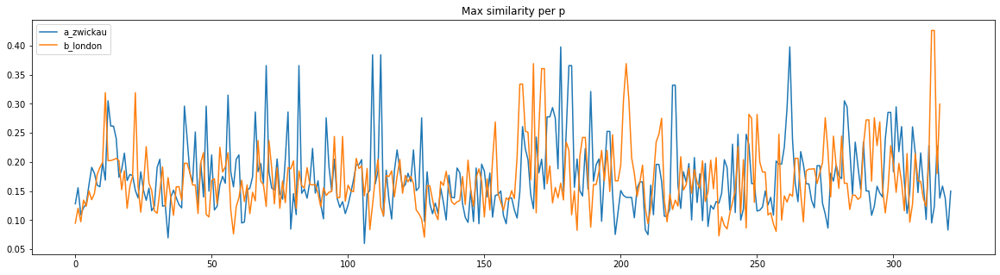

In [14]:
%matplotlib inline
fig, ax = plt.subplots(figsize=(20, 5))
ax.plot(a_zwickau_max_similarity_per_p, label="a_zwickau")
ax.plot(b_london_max_similarity_per_p, label="b_london")
ax.legend()
plt.title('Max similarity per p')
plt.show()

In [15]:
def cross_version_similarity(version_1_corpus, version_2_corpus):
    res = []
    for i, p in enumerate(version_1_corpus):
        temp_corpus = [p] + version_2_corpus
        df_features = get_features(temp_corpus)
        temp_similarities = cosine_similarity(df_features, df_features)
        res.append(temp_similarities[0])
    return res

In [16]:
a_zwickau_b_london_similarities = cross_version_similarity(a_zwickau_corpus, b_london_corpus)
b_london_a_zwickau_similarities = cross_version_similarity(b_london_corpus, a_zwickau_corpus)


In [17]:
show_similarities_data(a_zwickau_b_london_similarities)

___ max similariry for paragraph: 0 ___
index: [210] value: 0.04664241219042893
index: [318] value: 0.053945492593281415
index: [21] value: 0.07590465456826559
index: [20] value: 0.1061880236354058
index: [9] value: 0.13241211535415648
index: [0] value: 1.0000000000000004
average: 0.012922583526167252
0 similarities: 110

___ max similariry for paragraph: 1 ___
index: [314] value: 0.11447140683539764
index: [7] value: 0.11508727913027729
index: [6] value: 0.12013523111110302
index: [276] value: 0.13165047436060362
index: [2] value: 0.7891783291443909
index: [0] value: 0.9999999999999986
average: 0.05538085946987807
0 similarities: None

___ max similariry for paragraph: 2 ___
index: [221] value: 0.09001655022178745
index: [282] value: 0.09094160776580114
index: [6] value: 0.09332484610557207
index: [4] value: 0.0948385892725598
index: [3] value: 0.8650848920137588
index: [0] value: 1.0000000000000007
average: 0.041843735042379114
0 similarities: 2

___ max similariry for paragraph: 3 _

___ max similariry for paragraph: 235 ___
index: [113] value: 0.07389392624887106
index: [78] value: 0.07665939303373086
index: [238] value: 0.078011884155281
index: [152] value: 0.0871205145708039
index: [240] value: 0.8175921935075514
index: [0] value: 1.0000000000000004
average: 0.03218219410542467
0 similarities: 3

___ max similariry for paragraph: 236 ___
index: [262] value: 0.10551072110549013
index: [167] value: 0.10638366591211425
index: [105] value: 0.12137424722051693
index: [212] value: 0.12328773964565388
index: [241] value: 0.7563585351901826
index: [0] value: 0.9999999999999998
average: 0.03714848548262462
0 similarities: 4

___ max similariry for paragraph: 237 ___
index: [85] value: 0.08948446155980658
index: [229] value: 0.09183450243639377
index: [219] value: 0.10779683776119943
index: [250] value: 0.11939453664884951
index: [242] value: 0.714227116408734
index: [0] value: 1.0000000000000004
average: 0.03794820220971596
0 similarities: None

___ max similariry for pa

In [18]:
show_similarities_data(b_london_a_zwickau_similarities)

___ max similariry for paragraph: 0 ___
index: [195] value: 0.062173705317503575
index: [281] value: 0.06782481943464941
index: [292] value: 0.07088448406804548
index: [219] value: 0.07190529716494655
index: [275] value: 0.07651517080865211
index: [0] value: 1.0000000000000002
average: 0.012159576877632642
0 similarities: 154

___ max similariry for paragraph: 1 ___
index: [281] value: 0.11341682527837744
index: [6] value: 0.11489115774913738
index: [284] value: 0.11916333780519171
index: [7] value: 0.1445809987218223
index: [2] value: 0.7895087984083552
index: [0] value: 1.0
average: 0.05215366433847704
0 similarities: None

___ max similariry for paragraph: 2 ___
index: [284] value: 0.09322959070978236
index: [4] value: 0.09931113275563612
index: [213] value: 0.10959259594075704
index: [212] value: 0.11137454518845266
index: [3] value: 0.8683724496679202
index: [0] value: 0.9999999999999996
average: 0.04253311115108322
0 similarities: 1

___ max similariry for paragraph: 3 ___
index:

0 similarities: 2

___ max similariry for paragraph: 123 ___
index: [13] value: 0.12146166565414428
index: [183] value: 0.12998068944657654
index: [55] value: 0.13647394746845504
index: [170] value: 0.15945791526906858
index: [129] value: 0.44397188662542003
index: [0] value: 1.0000000000000002
average: 0.05907402063890735
0 similarities: None

___ max similariry for paragraph: 124 ___
index: [172] value: 0.09837706904175353
index: [230] value: 0.10022984215608235
index: [25] value: 0.10295269843571705
index: [133] value: 0.1164864176495015
index: [130] value: 0.6223934441861253
index: [0] value: 1.0000000000000007
average: 0.035545302599041644
0 similarities: 7

___ max similariry for paragraph: 125 ___
index: [124] value: 0.09129060166029322
index: [174] value: 0.09141496019112541
index: [87] value: 0.1059157357365743
index: [178] value: 0.11211913238090726
index: [131] value: 0.6396533748213905
index: [0] value: 1.0000000000000002
average: 0.04825804794987108
0 similarities: None

_

0 similarities: 2

___ max similariry for paragraph: 181 ___
index: [193] value: 0.08230446415710925
index: [181] value: 0.10684754853720484
index: [183] value: 0.1787368533534905
index: [182] value: 0.22130310699084715
index: [191] value: 0.35268411749932815
index: [0] value: 0.9999999999999998
average: 0.026513915604374546
0 similarities: 10

___ max similariry for paragraph: 182 ___
index: [189] value: 0.08842386921915883
index: [183] value: 0.08852979442183928
index: [193] value: 0.1144541044393125
index: [268] value: 0.11953761134202887
index: [192] value: 0.5801923585936857
index: [0] value: 1.0
average: 0.033733614986510146
0 similarities: 4

___ max similariry for paragraph: 183 ___
index: [89] value: 0.12146790110751
index: [263] value: 0.12517266838893426
index: [183] value: 0.14916412423459846
index: [185] value: 0.16923582315226196
index: [193] value: 0.473686779345835
index: [0] value: 1.000000000000001
average: 0.05875598027101261
0 similarities: None

___ max similariry 

0 similarities: None

___ max similariry for paragraph: 308 ___
index: [298] value: 0.12978636484185477
index: [283] value: 0.1311770662922517
index: [281] value: 0.1316893597207206
index: [314] value: 0.21802115876694692
index: [317] value: 0.8346496814099275
index: [0] value: 0.9999999999999996
average: 0.06105353026138185
0 similarities: None

___ max similariry for paragraph: 309 ___
index: [300] value: 0.098684515009434
index: [298] value: 0.10475362440546651
index: [317] value: 0.1114033615772139
index: [314] value: 0.14370673045774895
index: [318] value: 0.898481576751013
index: [0] value: 1.0000000000000002
average: 0.04224087469077181
0 similarities: 1

___ max similariry for paragraph: 310 ___
index: [300] value: 0.1346680944119525
index: [170] value: 0.13959427234950872
index: [314] value: 0.16018036037956812
index: [124] value: 0.16138773118749108
index: [319] value: 0.8443271894063058
index: [0] value: 1.000000000000001
average: 0.06970155661401975
0 similarities: None

__

In [19]:
a_zwickau_b_london_max_similarity_per_p = get_max_similarity_per_p(a_zwickau_b_london_similarities)
b_london_a_zwickau_max_similarity_per_p = get_max_similarity_per_p(b_london_a_zwickau_similarities)

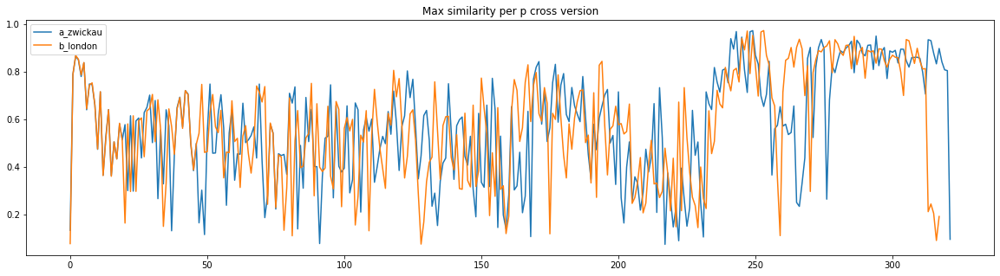

In [20]:
fig, ax = plt.subplots(figsize=(20, 5))
ax.plot(a_zwickau_b_london_max_similarity_per_p, label="a_zwickau")
ax.plot(b_london_a_zwickau_max_similarity_per_p, label="b_london")
ax.legend()
plt.title('Max similarity per p cross version')
plt.show()

In [21]:
def create_G_of_similaritis(similarities):
    G = nx.Graph()
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 6)
        max_indices_without_self = max_indices[:-1]
        G.add_node(index) # node himself
        for n in max_indices_without_self:
            G.add_node(n)
            weight = similarities[index][n]
            G.add_weighted_edges_from([(index, n, weight)])
    return G

In [22]:
def show_G(G):
    %matplotlib notebook

    fig = plt.figure(figsize=(10, 10))
    fig.canvas.manager.full_screen_toggle()

    pos=nx.spring_layout(G)
    nx.draw(
        G, 
        pos,
        with_labels=True, 
    )
    fig.show()

In [23]:
a_zwickau_G = create_G_of_similaritis(a_zwickau_similarities)
b_london_G = create_G_of_similaritis(b_london_similarities)

In [24]:
print(len(list(nx.connected_components(a_zwickau_G))))
print(len(list(nx.connected_components(b_london_G))))

1
1


In [25]:
a_zwickau_sorted_degree = sorted(a_zwickau_G.degree, key=lambda x: x[1], reverse=True)
print(a_zwickau_sorted_degree)

[(169, 44), (280, 35), (299, 35), (283, 31), (87, 31), (282, 26), (297, 24), (12, 22), (152, 20), (123, 19), (301, 17), (173, 17), (54, 16), (281, 16), (184, 16), (86, 15), (262, 15), (6, 14), (5, 14), (88, 14), (30, 14), (21, 13), (105, 13), (213, 13), (175, 13), (318, 12), (279, 12), (9, 12), (82, 12), (36, 12), (101, 12), (74, 12), (15, 11), (24, 11), (174, 11), (70, 10), (73, 10), (192, 10), (255, 10), (182, 10), (46, 9), (196, 9), (289, 9), (211, 9), (185, 9), (313, 9), (20, 9), (121, 9), (13, 9), (59, 9), (224, 9), (22, 9), (239, 9), (200, 9), (64, 9), (53, 9), (104, 9), (95, 9), (76, 9), (246, 9), (163, 9), (167, 9), (141, 9), (155, 9), (177, 9), (258, 9), (290, 9), (176, 9), (316, 9), (18, 8), (241, 8), (71, 8), (63, 8), (225, 8), (227, 8), (161, 8), (120, 8), (126, 8), (236, 8), (188, 8), (219, 8), (160, 8), (194, 8), (214, 8), (264, 8), (263, 8), (178, 8), (215, 8), (273, 8), (308, 8), (19, 7), (183, 7), (10, 7), (11, 7), (42, 7), (14, 7), (124, 7), (110, 7), (25, 7), (23, 7)

In [26]:
b_london_sorted_degree = sorted(b_london_G.degree, key=lambda x: x[1], reverse=True)
print(b_london_sorted_degree)

[(162, 37), (272, 29), (80, 28), (275, 27), (192, 27), (163, 26), (205, 24), (274, 24), (291, 21), (164, 21), (71, 20), (25, 20), (118, 19), (313, 16), (151, 16), (208, 16), (55, 15), (51, 15), (289, 14), (314, 14), (176, 13), (83, 13), (20, 13), (197, 13), (235, 13), (202, 13), (218, 13), (5, 12), (98, 12), (73, 12), (31, 12), (97, 12), (74, 12), (174, 12), (293, 12), (222, 12), (153, 12), (317, 11), (46, 11), (82, 11), (37, 11), (102, 11), (233, 11), (187, 10), (27, 10), (59, 10), (158, 10), (165, 10), (315, 10), (130, 10), (261, 10), (281, 9), (195, 9), (160, 9), (271, 9), (9, 9), (144, 9), (310, 9), (88, 9), (273, 9), (85, 9), (106, 9), (100, 9), (166, 9), (134, 9), (214, 9), (172, 9), (308, 9), (282, 9), (266, 8), (6, 8), (305, 8), (72, 8), (115, 8), (18, 8), (22, 8), (103, 8), (194, 8), (209, 8), (26, 8), (42, 8), (56, 8), (38, 8), (28, 8), (67, 8), (92, 8), (50, 8), (36, 8), (84, 8), (69, 8), (94, 8), (228, 8), (76, 8), (240, 8), (93, 8), (101, 8), (250, 8), (129, 8), (167, 8), 

In [27]:
a_zwickau_strongly_connected_nodes = [(node, degree) for node, degree in a_zwickau_sorted_degree if degree >= 10]
print(len(a_zwickau_strongly_connected_nodes))
print(a_zwickau_strongly_connected_nodes)

40
[(169, 44), (280, 35), (299, 35), (283, 31), (87, 31), (282, 26), (297, 24), (12, 22), (152, 20), (123, 19), (301, 17), (173, 17), (54, 16), (281, 16), (184, 16), (86, 15), (262, 15), (6, 14), (5, 14), (88, 14), (30, 14), (21, 13), (105, 13), (213, 13), (175, 13), (318, 12), (279, 12), (9, 12), (82, 12), (36, 12), (101, 12), (74, 12), (15, 11), (24, 11), (174, 11), (70, 10), (73, 10), (192, 10), (255, 10), (182, 10)]


In [28]:
b_london_strongly_connected_nodes = [(node, degree) for node, degree in b_london_sorted_degree if degree >= 10]
print(len(b_london_strongly_connected_nodes))
print(b_london_strongly_connected_nodes)

51
[(162, 37), (272, 29), (80, 28), (275, 27), (192, 27), (163, 26), (205, 24), (274, 24), (291, 21), (164, 21), (71, 20), (25, 20), (118, 19), (313, 16), (151, 16), (208, 16), (55, 15), (51, 15), (289, 14), (314, 14), (176, 13), (83, 13), (20, 13), (197, 13), (235, 13), (202, 13), (218, 13), (5, 12), (98, 12), (73, 12), (31, 12), (97, 12), (74, 12), (174, 12), (293, 12), (222, 12), (153, 12), (317, 11), (46, 11), (82, 11), (37, 11), (102, 11), (233, 11), (187, 10), (27, 10), (59, 10), (158, 10), (165, 10), (315, 10), (130, 10), (261, 10)]


<IPython.core.display.Javascript object>


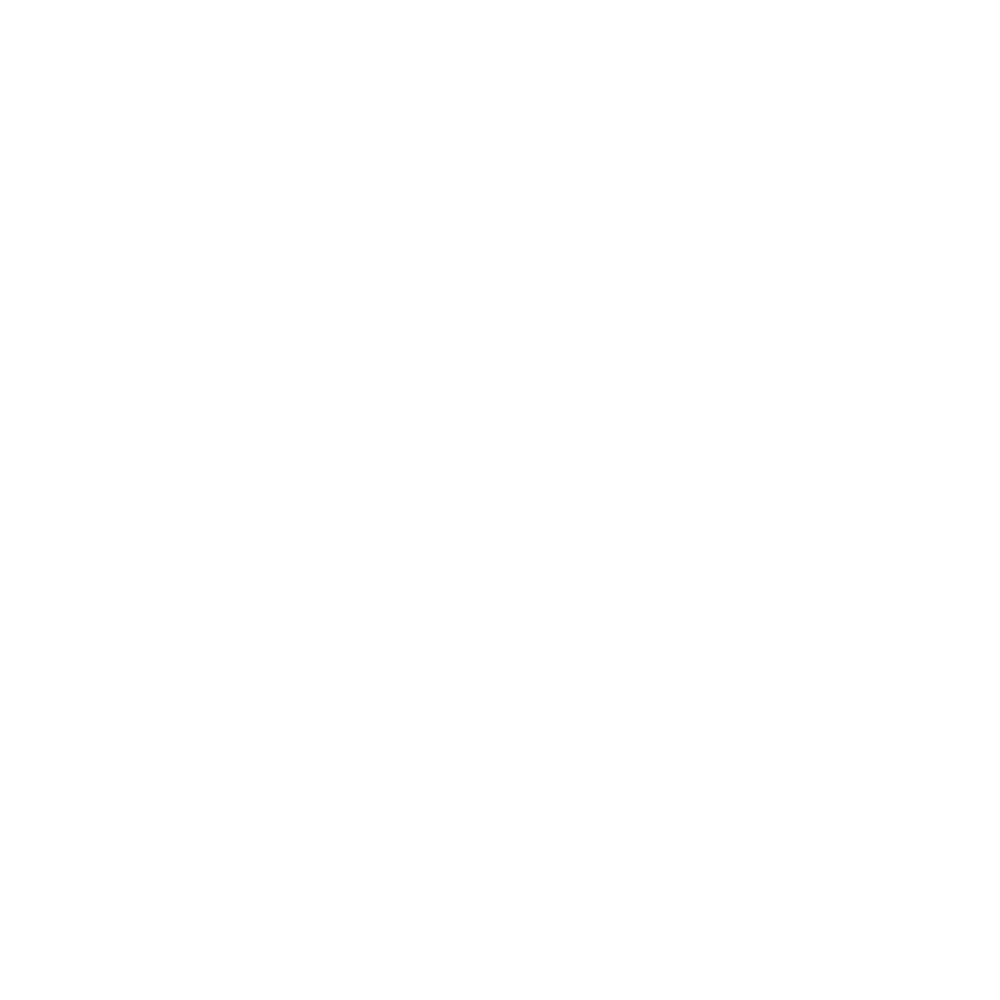

In [29]:
show_G(a_zwickau_G)

<IPython.core.display.Javascript object>


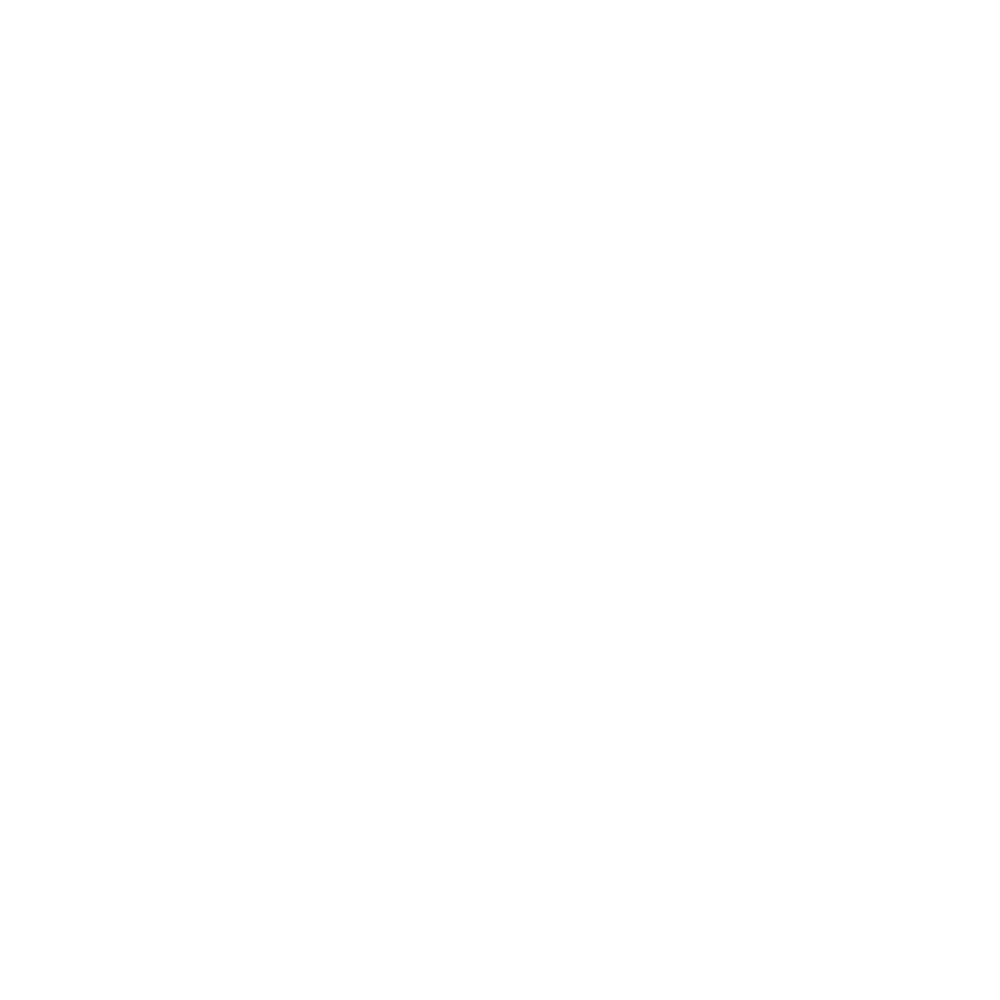

In [30]:
show_G(b_london_G)

In [31]:
%matplotlib inline
fig, axes = plt.subplots(318, 1, figsize=(20,900))
a_zwickau_similarities_df = pd.DataFrame(a_zwickau_similarities)
b_london_similarities_df = pd.DataFrame(b_london_similarities)

for i, ax in enumerate(axes.ravel()):
    ax.set_title(f'paragraph {i}')
    
    if i in list(a_zwickau_similarities_df.index):
        y_1 = a_zwickau_similarities_df.iloc[i, :]
        ax.plot(y_1, color='orange', label='a_zwickau')
    
    if i in list(b_london_similarities_df.index):
        y_2 = b_london_similarities_df.iloc[i, :]
        ax.plot(y_2, label='b_london')
        
    ax.grid()
    ax.set_ylim([0,1])
    ax.legend()

plt.show()

In [32]:
%matplotlib inline
fig, axes = plt.subplots(318, 1, figsize=(20,900))
a_zwickau_similarities_df = pd.DataFrame(a_zwickau_b_london_similarities)
b_london_similarities_df = pd.DataFrame(b_london_a_zwickau_similarities)

for i, ax in enumerate(axes.ravel()):
    ax.set_title(f'paragraph {i}')
    
    if i in list(a_zwickau_similarities_df.index):
        y_1 = a_zwickau_similarities_df.iloc[i,:]
        ax.plot(y_1, color='orange', label='a_zwickau')
    
    if i in list(b_london_similarities_df.index):
        y_2 = b_london_similarities_df.iloc[i,:]
        ax.plot(y_2, label='b_london')
        
    ax.grid()
    ax.set_ylim([0,1])
    ax.legend()

plt.show()